## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

In [1]:
!pip install opencv-python

    100% |████████████████████████████████| 40.3MB 1.1MB/s eta 0:00:01


In [1]:
def camera_cal(img, objpoints, imgpoints):
    """
    Method to compute the camera calibration using chessboard images
    """
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)   
    return mtx, dist

In [2]:
def cal_undistort(img,mtx, dist):
    """
    Returns the undistorted image
    """
    undist = cv2.undistort(img, mtx, dist, None, mtx) 
    return undist

In [22]:
def pipeline(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    """
    Compute a binary thresholded image
    by applying color and gradient thresholds to focus on lane lines
    Converts to HLS color space and separates 'value' channel
    """
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Compute Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different color
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    return color_binary, combined_binary

In [4]:
def corners_unwarp(undist,img_size,nx, ny, mtx, dist):
    """
    Perspective transform to convert into a bird’s eye view
    """
    lanewidth=300
    h=720
    w=1280

    # define src points through getting a plane in the image
    src = np.float32([(575,464),
                      (707,464), 
                      (258,682), 
                      (1049,682)])

    # Defining the destinations points through offset and w/h of the given image
    dest = np.float32([(lanewidth,0),
                      (w-lanewidth,0),
                      (lanewidth,h),
                      (w-lanewidth,h)])
    M = cv2.getPerspectiveTransform(src, dest)
    warped = cv2.warpPerspective(undist, M, img_size, flags=cv2.INTER_LINEAR)
    Minv = cv2.getPerspectiveTransform(dest, src)
        
    return warped, Minv

In [5]:
def find_lane_pixels(binary_warped):
    """
    Sliding window search to find lane lines.
    """
    
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        # Identify the boundaries of the window
        win_xleft_low = leftx_current-margin 
        win_xleft_high = leftx_current+margin
        win_xright_low = rightx_current-margin  
        win_xright_high = rightx_current+margin  
        
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy>=win_y_low)&(nonzeroy<=win_y_high)&(nonzerox>=win_xleft_low)&(nonzerox<=win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy>=win_y_low)&(nonzeroy<=win_y_high)&(nonzerox>=win_xright_low)&(nonzerox<=win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        #If found > minpix pixels, recenter next window
        if len(good_left_inds)>minpix:
            leftx_current= np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds)>minpix:
            rightx_current= np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    return leftx, lefty, rightx, righty, out_img,histogram, left_lane_inds,right_lane_inds


def fit_polynomial(binary_warped):
    """
    Find all pixels belonging to each lane line through the sliding window method.
    Then fit a polynomial to the detected left and right lanes.
    """

    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img,histogram,left_lane_inds,right_lane_inds = find_lane_pixels(binary_warped)
    
    #check for any lanes that are not detected in this current frame then use the history
    if (leftx.size < 5):
        left_lane.detected = False
        #print ("Left lane deteceted - False")
    else:
        left_lane.detected = True
        #print ("Left lane detected - true")
    
    if (rightx.size < 5):
        right_lane.detected = False
        #print ("Right lane detected False")
    else:
        right_lane.detected = True
        #print ("Right lane detected True")
        
    #print (left_lane.detected, right_lane.detected)
    
    #if lane is detected then try to fit the poly
    if left_lane.detected == True & right_lane.detected == True:
        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        left_lane.best_fit = np.vstack([left_lane.best_fit,left_fit])
        left_lane.best_fit[0] = left_fit
        right_lane.best_fit = np.vstack([right_lane.best_fit,right_fit])
        right_lane.best_fit[0] = right_fit
        left_lane.best_fit = np.average(left_lane.best_fit[-left_lane.smoothen_nframes:], axis = 0)
        right_lane.best_fit = np.average(right_lane.best_fit[-right_lane.smoothen_nframes:], axis = 0)
        #print ("saved best fit")
    else: 
        #use the history avg values 
        left_fit = left_lane.best_fit
        right_fit = right_lane.best_fit
        #print ("used previous best fit")
    #calculate the actual points in x and y is from 0 to 719
    ploty = np.linspace(0, out_img.shape[0]-1, out_img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    margin = 100
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    return result,left_fitx,right_fitx,ploty,left_fit,right_fit,leftx,rightx,lefty,righty, histogram

In [6]:
def measure_curvature_real(leftx,rightx,lefty, righty,ploty):
    """
    This function calculates the curvature of polynomial functions in meters."""
    
    y_eval = np.max(ploty)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curverad, right_curverad


In [7]:
def distance_to_middle(left_fit,right_fit):
    """
    This function returns the distance of the car to the middle.
    Positive values symbolize a right offset, a negative a left offset
    """
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Car middle target is in the middle of the image
    car_position = 1280/2

    rightx_int = right_fit[0]*720**2 + right_fit[1]*720 + right_fit[2]
    leftx_int = left_fit[0]*720**2 + left_fit[1]*720 + left_fit[2]
      
    lane_center = (rightx_int+leftx_int)/2
    center_dist = (car_position - lane_center) * xm_per_pix
    return center_dist

In [8]:
def draw_on_original(undist, left_fitx, right_fitx, ploty,Minv):
    """
    Function to draw computed 
    """
    
    # Create an image to draw the lines on
    color_warp = np.zeros_like(undist).astype(np.uint8)

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane with low confidence region in red
    cv2.fillPoly(color_warp, np.int_([pts]), (255, 0, 0))
    
    #confidence region in green
    shift = 50
    diff = (right_fitx - left_fitx)/2
    pts_left = np.array([np.transpose(np.vstack([left_fitx[400:], ploty[400:]]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx[400:], ploty[400:]])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], undist.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.4, 0)
    return result

### Main program

In [20]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import pickle
from global_lane import *
%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')
# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    img_copy=np.copy(img)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img_copy, (9,6), corners, ret)
        cv2.imshow('img',img_copy)
        cv2.waitKey(500)


In [11]:
##Camera calibration and storage in pickle file
mtx,dist= camera_cal(img_copy, objpoints, imgpoints)
dist_pickle = {}
dist_pickle["mtx"]= mtx
dist_pickle["dist"]= dist
pickle.dump(dist_pickle, open( "./dist_pickle.p", "wb" ))

Text(0.5, 1.0, 'Undistorted image')

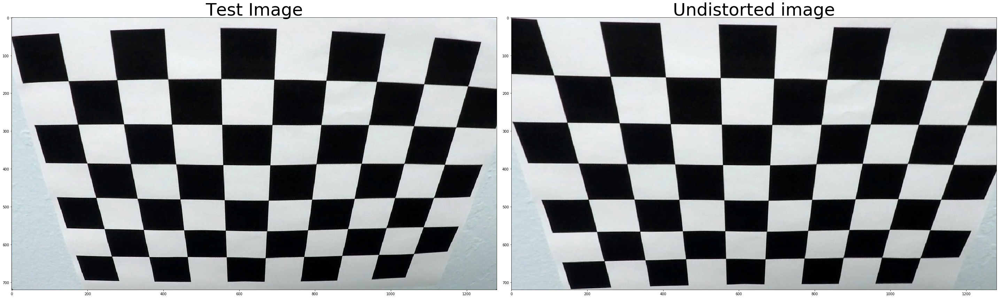

In [19]:
#Test undistortion on camera calibrated image
testimg = cv2.imread('./camera_cal/calibration2.jpg')
dist_pickle = pickle.load( open( "./dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
    
#Undistored image
undistorted= cal_undistort(testimg,mtx, dist) 
f, (ax1,ax2) = plt.subplots(1, 2, figsize=(40, 16))
f.tight_layout()
ax1.imshow(testimg)
ax1.set_title('Test Image', fontsize=50)
ax2.imshow(undistorted)
ax2.set_title('Undistorted image', fontsize=50)

/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


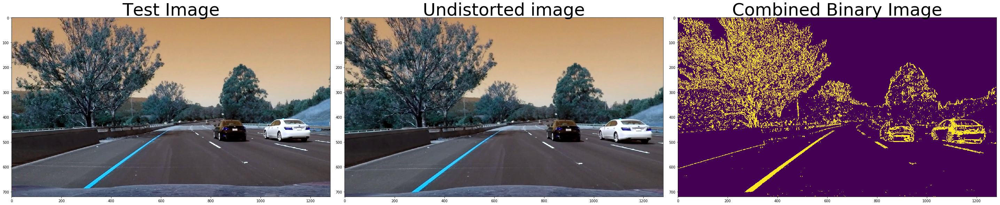

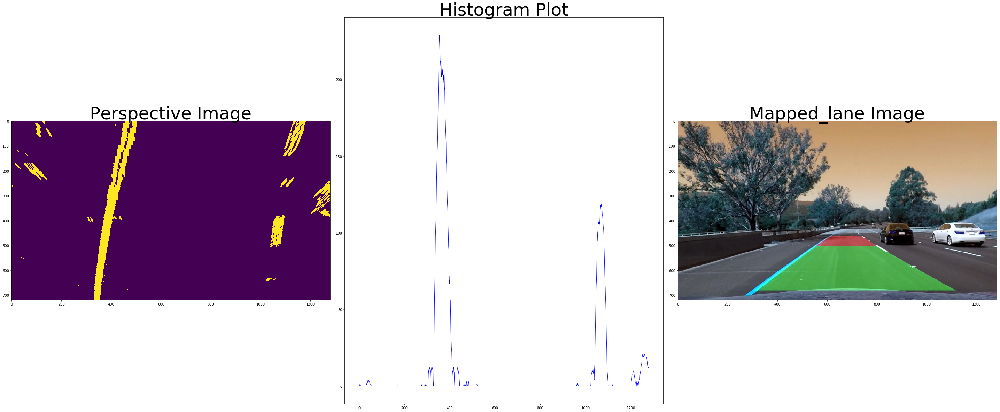

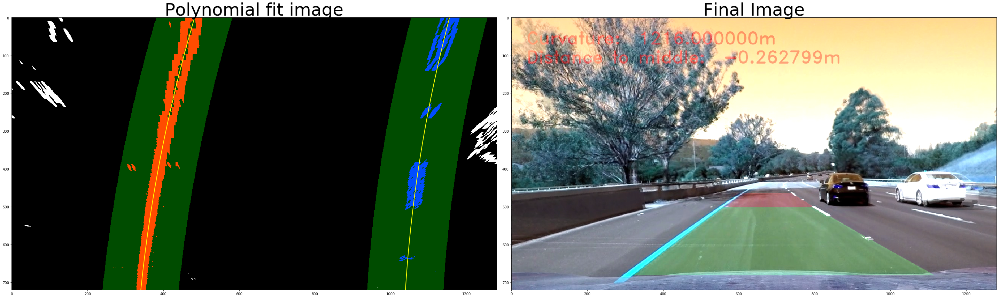

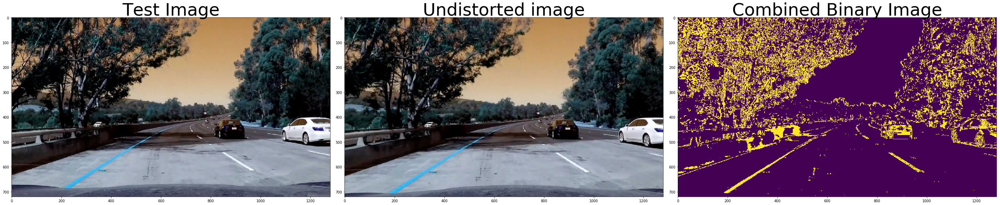

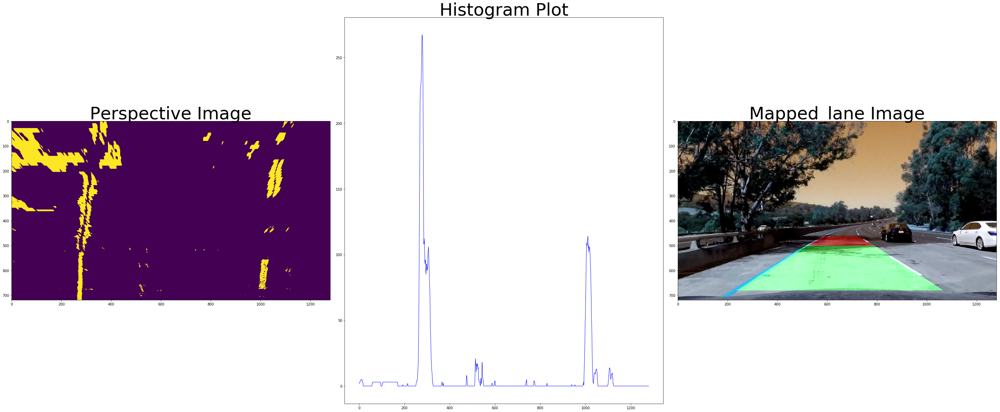

...

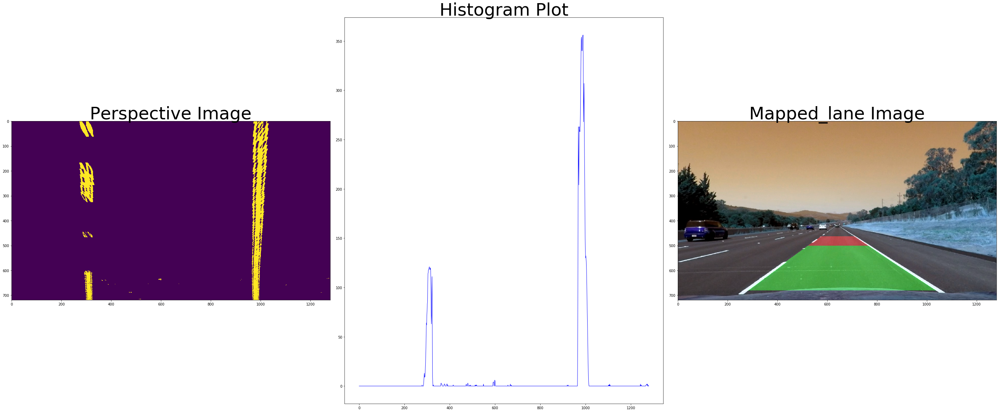

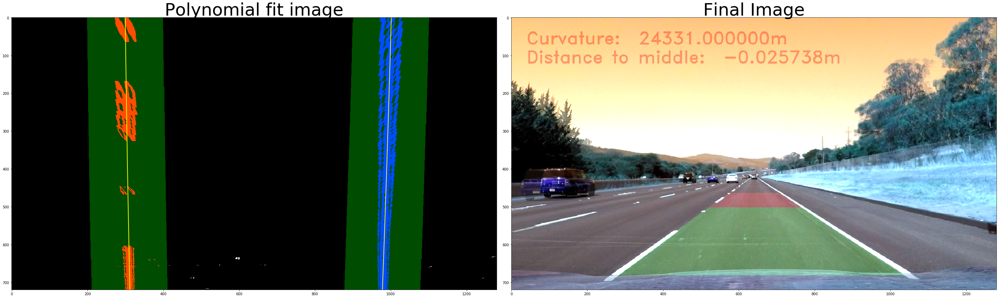

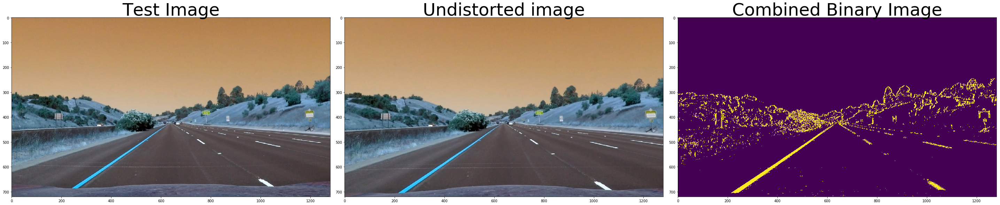

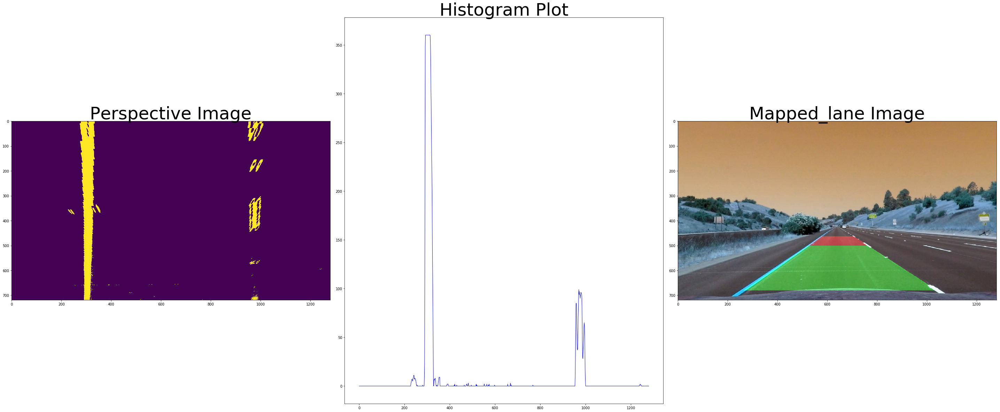

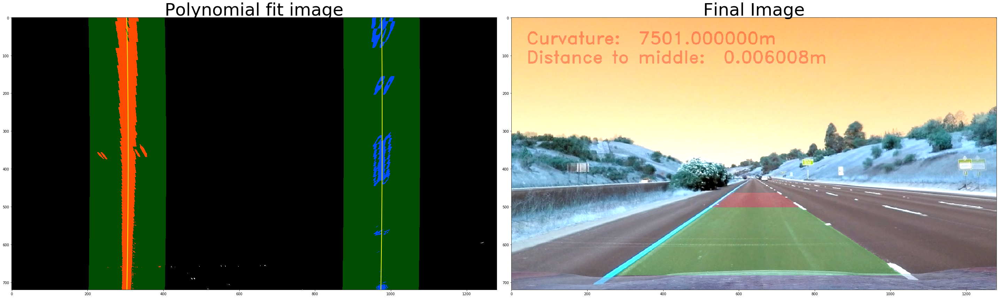

In [11]:
testimages = glob.glob('./test_images/*.jpg')     
image_no = 1
for fname in testimages:
    testimg = cv2.imread(fname)
    dist_pickle = pickle.load( open( "./dist_pickle.p", "rb" ) )
    
    #w
    mtx = dist_pickle["mtx"]
    dist = dist_pickle["dist"]
    
    #Undistored image
    undistorted= cal_undistort(testimg,mtx, dist)  
    img_size=(undistorted.shape[1],undistorted.shape[0])
   
    #Color thresholding
    color_binary, combined_binary= pipeline(undistorted)
       
    #Plotting section
    f, (ax1,ax2,ax3) = plt.subplots(1, 3, figsize=(40, 16))
    f.tight_layout()
    ax1.imshow(testimg)
    ax1.set_title('Test Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted image', fontsize=50)
    ax3.imshow(combined_binary)
    ax3.set_title('Combined Binary Image', fontsize=50)
    
    
    #Get perspective transform on undistorted image
    top_down_warped, perspective_M = corners_unwarp(combined_binary,img_size,9, 6, mtx, dist) 
    
    #Get polynomial fit perspective image after applying sliding window detection
    out_img, left_fitx, right_fitx, ploty,left_fit, right_fit,leftx, rightx,lefty, righty,histogram = fit_polynomial(top_down_warped)
    
    #Map detected fit onto inverse of perspective i.e. similar to the actual test image
    mapped_lane = draw_on_original(undistorted, left_fitx, right_fitx, ploty, perspective_M)
    
    #Plotting section
    f, (ax1,ax2,ax3) = plt.subplots(1, 3, figsize=(40, 16))
    f.tight_layout()
    ax1.imshow(top_down_warped)
    ax1.set_title('Perspective Image', fontsize=50)
    ax2.plot(histogram, color='blue', linewidth=1)    
    ax2.set_title('Histogram Plot', fontsize=50)
    ax3.imshow(mapped_lane)
    ax3.set_title('Mapped_lane Image', fontsize=50)
    
    #Find curvature 
    left_curverad, right_curverad = measure_curvature_real(leftx,rightx,lefty, righty,ploty)
     
    #Print curvature onto the mapped_lane image
    curvature = 'Curvature: ' + ' {:0.6f}'.format(int((left_curverad + right_curverad)/2)) + 'm '
    cv2.putText(mapped_lane, curvature, (40,70), cv2.FONT_HERSHEY_DUPLEX, 1.5, (255,0,0), 2, cv2.LINE_AA)
    
    #Find distance to middle and print onto the mapped_lane image
    distance = 'Distance to middle: ' + ' {:0.6f}'.format(distance_to_middle(left_fit,right_fit)) + 'm '
    cv2.putText(mapped_lane, distance, (40,120), cv2.FONT_HERSHEY_DUPLEX, 1.5, (255,0,0), 2, cv2.LINE_AA)
    
    finalimage= cv2.addWeighted(testimg, 1, mapped_lane, 0.5, 0)
    
    #Plotting section
    f, (ax1,ax2) = plt.subplots(1, 2, figsize=(40, 16))
    f.tight_layout()   
    ax1.plot(left_fitx,ploty, color='yellow', linewidth=2)
    ax1.plot(right_fitx,ploty, color='yellow', linewidth=2)
    ax1.imshow(out_img)
    ax1.set_title('Polynomial fit image', fontsize=50)
    ax2.imshow(finalimage)
    ax2.set_title('Final Image', fontsize=50)
    ax2.figure.savefig('./output_images/test_output_'+str(image_no)+'.jpg')
    
    image_no+=1

In [11]:
def pipeline_video(process_image):
    dist_pickle = pickle.load( open( "./dist_pickle.p", "rb" ) )
    
    #Retrieve mtx and dist from pickle file
    mtx = dist_pickle["mtx"]
    dist = dist_pickle["dist"]
    
    #Undistored image
    undistorted= cal_undistort(process_image,mtx, dist)  
    img_size=(undistorted.shape[1],undistorted.shape[0])
   
    #Color thresholding
    color_binary, combined_binary= pipeline(undistorted)
    
    #Get perspective transform on undistorted image
    top_down_warped, perspective_M = corners_unwarp(combined_binary,img_size,9, 6, mtx, dist) 
    
    #Get polynomial fit perspective image after applying sliding window detection
    out_img, left_fitx, right_fitx, ploty,left_fit, right_fit,leftx, rightx,lefty, righty,histogram = fit_polynomial(top_down_warped)
    
    #Map detected fit onto inverse of perspective i.e. similar to the actual test image
    mapped_lane = draw_on_original(undistorted, left_fitx, right_fitx, ploty, perspective_M)
    
    #Find curvature 
    left_curverad, right_curverad = measure_curvature_real(leftx,rightx,lefty, righty,ploty)
     
    #Print curvature onto the mapped_lane image
    curvature = 'Curvature: ' + ' {:0.6f}'.format(int((left_curverad + right_curverad)/2)) + 'm '
    cv2.putText(mapped_lane, curvature, (40,70), cv2.FONT_HERSHEY_DUPLEX, 1.5, (255,0,0), 2, cv2.LINE_AA)
    
    #Find distance to middle and print onto the mapped_lane image
    distance = 'Distance to middle: ' + ' {:0.6f}'.format(distance_to_middle(left_fit,right_fit)) + 'm '
    cv2.putText(mapped_lane, distance, (40,120), cv2.FONT_HERSHEY_DUPLEX, 1.5, (255,0,0), 2, cv2.LINE_AA)
    
    finalimage= cv2.addWeighted(process_image, 1, mapped_lane, 0.5, 0)
    return finalimage

In [12]:
!pip install moviepy

In [12]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [15]:
output = 'project_video_output.mp4'
## Test pipeline on a shorter subclip of the video (5 sec)
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## Uncomment next line to test pipeline on 5 second subclip
#clip1 = VideoFileClip('challenge_video.mp4').subclip(0,5)

## Pipeline applied to actual video clip
clip1 = VideoFileClip("project_video.mp4")
clip = clip1.fl_image(pipeline_video)
clip.write_videofile(output, audio=False)

t:   0%|          | 2/1260 [00:00<02:06,  9.91it/s, now=None]

Moviepy - Building video project_video_output.mp4.
Moviepy - Writing video project_video_output.mp4



Moviepy - Done !
Moviepy - video ready project_video_output.mp4


In [16]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output))